# Neural Network Experiments

## Author: Alexander Goudemond, Student Number: 219030365

In this notebook, we do the following:

- Identify the best performing model out of the 18 models trained in 012

- Use that information to identify the best Patch Size to evaluate on

- Verify observations for each dataset, for each model

The summaries of the models done in 012 can be found here:

| Dataset | Model Name                  | Patch Size | Mean IoU Score | Observations |
|---------|-----------------------------|------------|----------------|-------|
| GT      | UNET_Model_Dimension_128_1  | 128        | 0.000202       | Fuzzy |
| GT      | UNET_Model_Dimension_128_2  | 128        | 0.232335       | Decent|
| GT      | UNET_Model_Dimension_128_3  | 128        | 0.230308       | Decent|
|         |                             |            |                |       |
| GT      | UNET_Model_Dimension_256_1  | 256        | 0.097374       | Fuzzy |
| GT      | UNET_Model_Dimension_256_2  | 256        | 0.449333       | Mixed |
| GT      | UNET_Model_Dimension_256_3  | 256        | 0.425110       | Decent|
|         |                             |            |                |       |
| GT      | UNET_Model_Dimension_512_1  | 512        | 0.067855       | Fuzzy |
| GT      | UNET_Model_Dimension_512_2  | 512        | 0.262273       | Fuzzy |
| GT      | UNET_Model_Dimension_512_3  | 512        | 0.299222       | Mixed |
|         |                             |            |                |       |
| ST      | UNET_Model_Dimension_128_1  | 128        | 0.428539       | Fuzzy |
| ST      | UNET_Model_Dimension_128_2  | 128        | 0.539064       | Mixed |
| ST      | UNET_Model_Dimension_128_3  | 128        | 0.536814       | Mixed |
|         |                             |            |                |       |
| ST      | UNET_Model_Dimension_256_1  | 256        | 0.548595       | Mixed |
| ST      | UNET_Model_Dimension_256_2  | 256        | 0.729635       | Decent|
| ST      | UNET_Model_Dimension_256_3  | 256        | 0.773320       | Decent|
|         |                             |            |                |       |
| ST      | UNET_Model_Dimension_512_1  | 512        | 1.992501e-06   | Mixed |
| ST      | UNET_Model_Dimension_512_2  | 512        | 0              | Decent|
| ST      | UNET_Model_Dimension_512_3  | 512        | 0.5005644      | Excellent|

It is worth noting that for all of those Mean IoU scores, the probability threshold was 0.5. Thus, if a model scored poorly, adjusting the threshold could improve things.

Model 1 had 30 epochs and a batch size of 4

Model 1 had 100 epochs and a batch size of 4

Model 1 had 100 epochs and a batch size of 8

Due to RAM issues - the models with a patch size of 512 had less training data as well

From that table, the following trends seem to appear:

For GT:

- 30 epochs is terrible. The IoU score is low, and the images seem to be fuzzy

- Patch size of 256 appears to be the best, producing good observable cells

- Patch size of 512 produces bad results - possibly because of the small training set used 

For ST:

- 30 epochs seems to be okay in terms on IoU score, but the cells are either fuzzy or halfway decent

- Patch size of 128 and 256 appears to do very well, with regards to IoU score and observations

- Patch size of 512 produces bad results - possibly because of the small training set used

Thus, we can suspect the following:

- 30 epochs is not worth doing. The minimum training time should be set to somewhere between 50 and 100 epochs (if not higher)

- Patch sizes of 512 should be avoided as we run into RAM issues inside Google Colab

- Patch sizes of 256 seem to produce good results. Further investigations are needed

In the rest of this notebook, we will generate a prediction on an entire image, in order to visually comment on the model's success. This will be done in the following stages:

- Select 1 image and 1 mask from each dataset (10 images in total)

- Crop all the images to an appropriate dimension, based on Patch Size

- Patchify only the image, and store them in an array

- Use the respective model to predict those patchified images, and store them

- Build a complete image from those predictions, by inverting the Patchify Process

- Plot the Original Image, the Original Mask and the Predicted Mask together

Those final 5 steps will execute for each model... Meaning we will have 18 images, each containing 1 image from the individual datasets

# Mount Drive

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
from os import getcwd
google_drive_path = "/drive/MyDrive"
training_data_directory = getcwd() + google_drive_path + "/COMP700_Images/"

Please ensure the following folders containg images exist:

drive > MyDrive > COMP700_Images > COMP700_Processed_Training_GT

drive > MyDrive > COMP700_Images > COMP700_Processed_Training_ST

drive > MyDrive > COMP700_Images > COMP700_Raw_Training_GT

drive > MyDrive > COMP700_Images > COMP700_Raw_Training_ST

drive > MyDrive > COMP700_Images > COMP700_Patchify_Images_128_GT

drive > MyDrive > COMP700_Images > COMP700_Patchify_Images_256_GT

drive > MyDrive > COMP700_Images > COMP700_Patchify_Images_512_GT

drive > MyDrive > COMP700_Images > COMP700_Patchify_Images_128_ST

drive > MyDrive > COMP700_Images > COMP700_Patchify_Images_256_ST

drive > MyDrive > COMP700_Images > COMP700_Patchify_Images_512_ST

drive > MyDrive > COMP700_Images > COMP700_Patchify_Images_Processed_Images_GT

drive > MyDrive > COMP700_Images > COMP700_Patchify_Images_Processed_Images_ST

------------------------------------------------------

Then, please ensure a seperate folder with the notebooks and text files exists:

drive > MyDrive > COMP700_Neural_Network_Code

------------------------------------------------------

The first 4 image folders were generated offline by the other notebooks and then uploaded to Google Drive, whereas the next 6 were generated by the notebook 011. The final 2 were generated by 015

# Installs

In [ ]:
!pip install patchify

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


# Imports

In [ ]:
from os import getcwd, walk, mkdir, stat, remove
from os import sep # used later on, in a function, to print directory contents
from os.path import exists, basename, join

from shutil import copyfile

from PIL.Image import fromarray
import cv2

import matplotlib.pyplot as plt
import numpy as np

from patchify import patchify, unpatchify

import tensorflow as tf
from tensorflow import keras
from keras.layers import Conv2D, Dropout, MaxPooling2D, Conv2DTranspose, concatenate, Input, Lambda
from keras.metrics import MeanIoU

from sklearn.preprocessing import MinMaxScaler, StandardScaler

from IPython.display import clear_output


# Useful functions

In [ ]:
def getImagePaths(path):
    image_paths = []
    for root, dirs, files in walk(path):
        if (len(files) != 0):
          # print(len(files))
          image_paths.append( root )

    image_paths.sort()

    return image_paths
###

In [ ]:
# returns tuple
def extractDirectoryPaths(path):
    x_directory_locations, y_directory_locations = [], []
    temp = ""

    with open(path) as f:
        lines = f.readlines()
        for item in lines:
            temp = item[ : -1] # remove newline char at end
            if ("X" in temp):
                x_directory_locations.append( temp ) 
            else:
                y_directory_locations.append( temp ) 

    return (x_directory_locations, y_directory_locations)
###

def loadImagePathsFromArray(array):
    image_paths = []

    for path in array:
        for root, dirs, files in walk(path):
            if (len(files) != 0):
                for item in files:
                    image_paths.append(root + "/" + item)

    image_paths.sort()

    return image_paths
###

In [ ]:
# assume cropped already
def patchifyIndividualImage(image, patch_size, isColourImage=True):
    scaler = MinMaxScaler()
    image_dataset = []

    print("Patchify process starting!")

    #Extract patches from each image
    if (isColourImage):
        patches_img = patchify(image, (patch_size, patch_size, 3), step=patch_size)
    else:
        patches_img = patchify(image, (patch_size, patch_size), step=patch_size) # grayscale patchify
    
    for i in range(patches_img.shape[0]):
        for j in range(patches_img.shape[1]):
            single_patch_img = patches_img[i,j,:,:]
            
            #Use minmaxscaler instead of just dividing by 255. 
            single_patch_img = scaler.fit_transform(
                single_patch_img.reshape(-1, single_patch_img.shape[-1])
            ).reshape( single_patch_img.shape )
            
            #single_patch_img = (single_patch_img.astype('float32')) / 255. 
            #Drop the extra unecessary dimension that patchify adds. 
            single_patch_img = single_patch_img[0] 

            # scale up values - don't do this for the NN!
            # img_new = (single_patch_img * 255).astype(int) 
            img_new = single_patch_img

            image_dataset.append(img_new)

    print("Patchify process complete!")

    return image_dataset
###

In [ ]:
from tensorflow import keras
from keras.utils import array_to_img

def display(display_list, title=[], figsize=(15, 15)):
    plt.figure(figsize=figsize)

    # update if title not provided
    if (len(title) == 0):
      title = ['Input Image', 'True Mask', 'Predicted Mask']

    for i in range(len(display_list)):
        plt.subplot(1, len(display_list), i+1)
        plt.title(title[i], wrap=True)
        
        # handle 2D and 3D images
        if (len(display_list[i].shape) == 3 ):
            plt.imshow( array_to_img(display_list[i]), cmap="gray")
        else:
            plt.imshow( display_list[i], cmap="gray")
            
        plt.axis('off')
    plt.tight_layout() # prevents overlap
    plt.show()
###


In [ ]:
# create directories for work we create
def tryMakeDirectories(current_directory, myList):
    path = ""
    for item in myList:
        # initialize
        if (path == ""):
            path = item
        else:
            path = path + "/" + item
            
        try:
            # join comes from os.path
            mkdir( join(current_directory, path) )
        except FileExistsError:
            # print("Folder already exists!")
            pass
        except:
            print("Unknown Error Encountered...")
###

In [ ]:
def extractRhsString(string, symbol):
    index = string.rfind(symbol)
    return string[ index + len(symbol) : ]
###

def extractLhsString(string, symbol):
    index = string.find(symbol)
    return string[ : index ]
###

# Loading GT and ST Training Data

Here, we can read in the contents of our desired text files and prepare them to be shuffled

In [ ]:
google_drive_path = "/drive/MyDrive"
text_file_location = getcwd() + google_drive_path + "/COMP700_Neural_Network_Code/"

Extract and load Image

In [ ]:
filename = "raw_training_paths_gt.txt"
gt_x_image_paths, gt_y_image_paths = extractDirectoryPaths(text_file_location + filename)

gt_x_images = loadImagePathsFromArray(gt_x_image_paths)
gt_y_images = loadImagePathsFromArray(gt_y_image_paths)

if (len(gt_x_images) == len(gt_y_images)):
    print("Same quantity of images and masks!")
else:
    print("Not all pictures match...")

Same quantity of images and masks!


In [ ]:
filename = "raw_training_paths_st.txt"
st_x_image_paths, st_y_image_paths = extractDirectoryPaths(text_file_location + filename)

st_x_images = loadImagePathsFromArray(st_x_image_paths)
st_y_images = loadImagePathsFromArray(st_y_image_paths)

if (len(st_x_images) == len(st_y_images)):
    print("Same quantity of images and masks!")
else:
    print("Not all pictures match...")

Same quantity of images and masks!


In [ ]:
print("There are", len(st_x_images), "ST images and", len(gt_x_images), "GT images")

There are 7742 ST images and 578 GT images


Next, we need to partition the data, as we desire to select 1 image from each folder:

In [ ]:
gt_directory_list = []
temp = ""
count = 0

for path in gt_x_image_paths:
    if (count % 2 == 0):
        temp = extractRhsString(path, "GT/")
        temp = extractLhsString(temp, "/")
        # print(temp)
        gt_directory_list.append(temp)

    count += 1

gt_directory_list

['BF-C2DL-HSC',
 'BF-C2DL-MuSC',
 'DIC-C2DH-HeLa',
 'Fluo-C2DL-Huh7',
 'Fluo-C2DL-MSC',
 'Fluo-N2DH-GOWT1',
 'Fluo-N2DH-SIM+',
 'Fluo-N2DL-HeLa',
 'PhC-C2DH-U373',
 'PhC-C2DL-PSC']

In [ ]:
st_directory_list = []
temp = ""
count = 0

for path in st_x_image_paths:
    if (count % 2 == 0):
        temp = extractRhsString(path, "ST/")
        temp = extractLhsString(temp, "/")
        # print(temp)
        st_directory_list.append(temp)

    count += 1

st_directory_list

['BF-C2DL-HSC',
 'BF-C2DL-MuSC',
 'DIC-C2DH-HeLa',
 'Fluo-C2DL-MSC',
 'Fluo-N2DH-GOWT1',
 'Fluo-N2DL-HeLa',
 'PhC-C2DH-U373',
 'PhC-C2DL-PSC']

In [ ]:
def redesignImagePaths(array, directory_list):
    temp_2d_array = []
    temp_array = []
    count = 0
    next_directory = ""

    for path in array:
        # initialize
        if (count == 0):
            next_directory = directory_list[count]
            count += 1
        
        if (next_directory in path and count <= len(directory_list)):
            # print(path)
            # print(count)
            
            if (count < len(directory_list)):
                next_directory = directory_list[count]

            # place all contents into 2d array
            temp_2d_array.append(temp_array)

            temp_array = [] # reset
            count += 1 

        else:
            temp_array.append(path)

    # at end, append final list
    temp_2d_array.append(temp_array)  

    return temp_2d_array[ 1 : ] # remove dummy element

In [ ]:
gt_x_images = redesignImagePaths(gt_x_images, gt_directory_list)

len(gt_x_images)

10

In [ ]:
gt_y_images = redesignImagePaths(gt_y_images, gt_directory_list)

len(gt_y_images)

10

In [ ]:
st_x_images = redesignImagePaths(st_x_images, st_directory_list)

len(st_x_images)

8

In [ ]:
st_y_images = redesignImagePaths(st_y_images, st_directory_list)

len(st_y_images)

8

# Select random images

In [ ]:
from random import randint

random_gt_x_paths = []
random_gt_y_paths = []
index = 0
count = 0

for paths in gt_x_images:
    # print(paths)
    index = randint(0, len(paths)-1)

    random_gt_x_paths.append(gt_x_images[count][index])
    random_gt_y_paths.append(gt_y_images[count][index])

    count += 1 

count = 0
for i in range(len(random_gt_x_paths)):
    if (extractRhsString(random_gt_x_paths[i], "/t") 
        != 
        extractRhsString(random_gt_y_paths[i], "/man_seg")
        ):
        count += 1

print(count, "image(s) do not match")

0 image(s) do not match


In [ ]:
from random import randint

random_st_x_paths = []
random_st_y_paths = []
index = 0
count = 0

for paths in st_x_images:
    # print(paths)
    index = randint(0, len(paths)-1)

    random_st_x_paths.append(st_x_images[count][index])
    random_st_y_paths.append(st_y_images[count][index])

    count += 1 

count = 0
for i in range(len(random_st_x_paths)):
    if (extractRhsString(random_st_x_paths[i], "/t") 
        != extractRhsString(random_st_y_paths[i], "/man_seg")):
        count += 1

print(count, "image(s) do not match")

0 image(s) do not match


# Prepare predictions

Here, we do the following:

- Crop all the images to an appropriate dimension, based on Patch Size

- Patchify the image, and store them in an array

- Use the respective model to predict those patchified images, and store them

- Build a complete image from those predictions, by inverting the Patchify Process

- Plot the Original Image, the Original Mask and the Predicted Mask together

## Crop Images


In [ ]:
def cropImage(image, patch_size):
    #Nearest size divisible by our patch size
    SIZE_X = (image.shape[1] // patch_size) * patch_size 
    SIZE_Y = (image.shape[0] // patch_size) * patch_size 

    image = fromarray(image)
    # Crop entire image into desirable shape
    image = image.crop((0 ,0, SIZE_X, SIZE_Y))  
    image = np.array(image)
    
    return image
###

# save and read all to ensure dtype=uint8
def readImage(img_path):
    image = plt.imread(img_path)
    plt.imsave("temp.png", image, cmap='gray')
    image = cv2.imread("temp.png")

    # try ensure 8 bit images used
    # x = x.astype(int)
    # y = np.array(x, dtype="uint8")

    return image
###
###

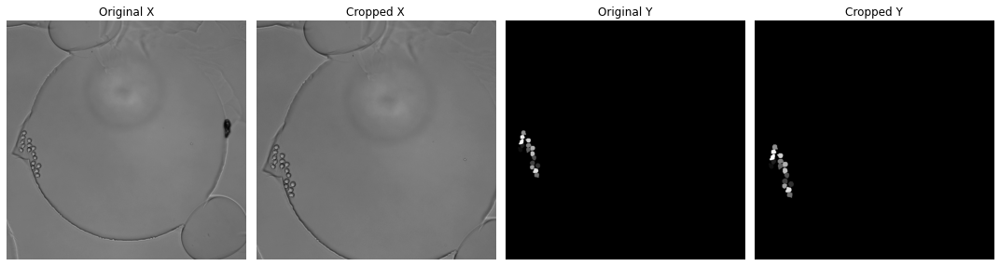

In [ ]:
# verify cropping is working

array = [readImage(random_gt_x_paths[0]),
         cropImage( readImage(random_gt_x_paths[0]), 128),
         readImage(random_gt_y_paths[0]),
         cropImage( readImage(random_gt_y_paths[0]), 128)  ]
labels = ["Original X", "Cropped X", "Original Y", "Cropped Y"]

display(array, labels)

## Patchify Images

Next, we patchify our original image

In [ ]:
patchified_images = patchifyIndividualImage(readImage(random_gt_x_paths[0]), patch_size=128)

len(patchified_images)

Patchify process starting!
Patchify process complete!


49

## Load and use Model

Next, load a model and use it to predict:

In [ ]:
from keras.models import load_model

training_data_code = getcwd() + google_drive_path + "/COMP700_Neural_Network_Code/"
path = training_data_code + "COMP700_UNet_Models/GT_128/"

new_model = load_model(path + "gt_128_model_1")

# Check its architecture
new_model.summary()

Model: "UNET_Model_Dimension_128_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 Input (InputLayer)             [(None, 128, 128, 3  0           []                               
                                )]                                                                
                                                                                                  
 c1_a (Conv2D)                  (None, 128, 128, 16  448         ['Input[0][0]']                  
                                )                                                                 
                                                                                                  
 c1_b (Dropout)                 (None, 128, 128, 16  0           ['c1_a[0][0]']                   
                                )                                        

In [ ]:
# predict:
patchified_images = np.array(patchified_images)

patchified_predictions = new_model.predict(patchified_images)

2/2 [==============================] - 2s 627ms/step


### Sneaky grayscale colours

We next need to format the patchified masks to be Grayscale images, otherwise sneaky colours can creep in. The colours come in because of the dimensions - RGB. To prove this, refer to the following:

Update predictions via a threshold

In [ ]:
print("Max Value:", np.max(patchified_predictions))
print("Min Value:", np.min(patchified_predictions))
print("Average value:", np.average(patchified_predictions))

Max Value: 0.47087765
Min Value: 0.00048469685
Average value: 0.009394733


In [ ]:
threshold = 0.1

patchified_predictions_thresh = patchified_predictions 
patchified_predictions_thresh[patchified_predictions_thresh >= threshold] = 1
patchified_predictions_thresh[patchified_predictions_thresh < threshold] = 0

In [ ]:
patchified_predictions_thresh[i].shape

(128, 128, 3)

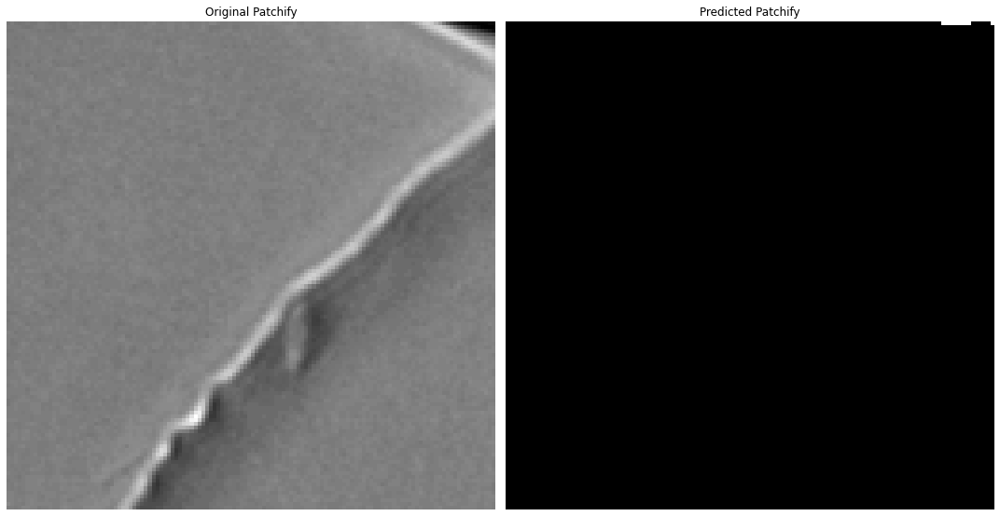

In [ ]:
i = 8
array = [ patchified_images[i], patchified_predictions_thresh[i] ]
labels = ["Original Patchify", "Predicted Patchify"]

display(array, labels)

### Fixing sneaky grayscale colours

So, let us format the images:

In [ ]:
from keras.utils import array_to_img

def convertFloatRGBtoBinary(img):
    plt.imsave("temp.png", img)
    gray = cv2.imread("temp.png", cv2.IMREAD_GRAYSCALE)

    if (exists("temp.png")):
        remove("temp.png")

    gray[gray < 255] = 0
    gray[gray == 255] = 1

    return gray.astype(float)
###

In [ ]:
np.unique( convertFloatRGBtoBinary(patchified_predictions_thresh[i]) )

array([0., 1.])

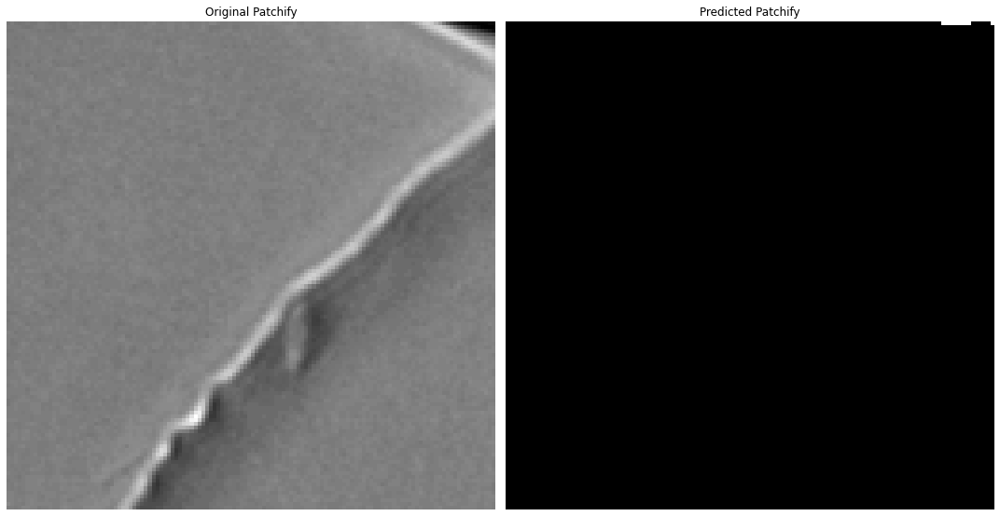

In [ ]:
i = 8
array = [ patchified_images[i], convertFloatRGBtoBinary(patchified_predictions_thresh[i]) ]
labels = ["Original Patchify", "Predicted Patchify"]

display(array, labels)

## Rebuild image

The Patchify function we have built uses a MinMaxScaler from SKLearn. This function works in the following way (Note that X is an integer array):

$\frac{X-X.min}{X.max-X.min} = float\_value$

Re-arranging this, we can show that:

$float\_value * (X.max - X.min) + X.min = X$

Therefore, that will be our inverse scaling operation

The only caviat is the Min and Max values need to come from our original array, so we will use patchify alongside this as well:

In [ ]:
def reshapePatchifiedImages(og_image, patches, height, width, patch_size, invert_scaling=True):
    # use original patchify to get integer slices of image
    collection = patchify(og_image, (patch_size, patch_size, 3), step=patch_size)
    counter = 0
    row_of_images, organised_patches = [], []

    # i * j == (patchifyIndividualImage(...).shape)[0]
    for i in range(height // patch_size):
        for j in range(width // patch_size):
            single_image = patches[counter]                   # 3D object

            # map to integer again?
            if (invert_scaling):
                # use og_image patches to find min and max ints
                min = np.min(collection[i,j,:,:][0])
                max = np.max(collection[i,j,:,:][0])
                single_image = (single_image * (max - min)) + min

            new_img = [single_image]                          # 4D object    
            
            row_of_images.append( new_img )

            counter += 1
        
        # print(len(row_of_images))
        organised_patches.append( row_of_images )             # stick rows ontop of one another
        row_of_images = [] 
    
    return organised_patches
###

In [ ]:
# get patches, without scaling

cropped_img = cropImage( readImage(random_gt_x_paths[4]), 128)
x, y, _ = np.array(cropped_img).shape

patches = patchifyIndividualImage(cropped_img, patch_size=128)

redesigned_images = reshapePatchifiedImages(cropped_img, patches, height=x, width=y, patch_size=128, invert_scaling=False)

Patchify process starting!
Patchify process complete!


In [ ]:
redesigned_images = np.array(redesigned_images)

rebuilt_image = unpatchify(redesigned_images, np.array(cropped_img).shape)

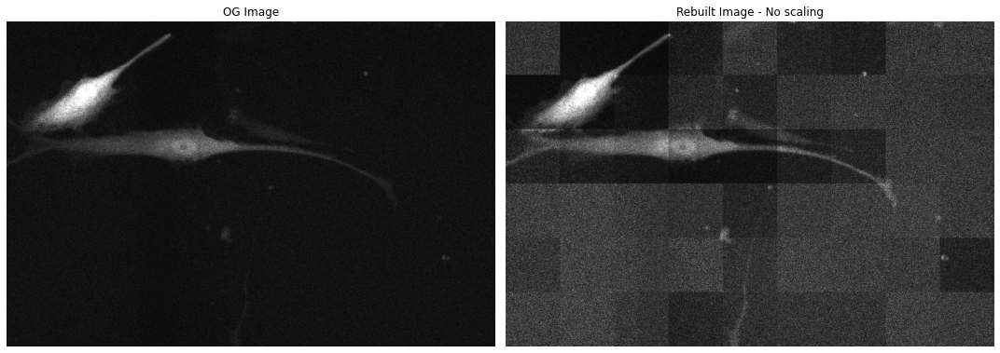

In [ ]:
array = [cropped_img, rebuilt_image]
labels = ["OG Image", "Rebuilt Image - No scaling"]

display(array, labels)

In [ ]:
# get patches, with scaling

cropped_img = cropImage( readImage(random_gt_x_paths[4]), 128)
x, y, _ = np.array(cropped_img).shape

patches = patchifyIndividualImage(cropped_img, patch_size=128)

redesigned_images = reshapePatchifiedImages(cropped_img, patches, height=x, width=y, patch_size=128, invert_scaling=True)

Patchify process starting!
Patchify process complete!


In [ ]:
redesigned_images = np.array(redesigned_images)

rebuilt_image = unpatchify(redesigned_images, np.array(cropped_img).shape)

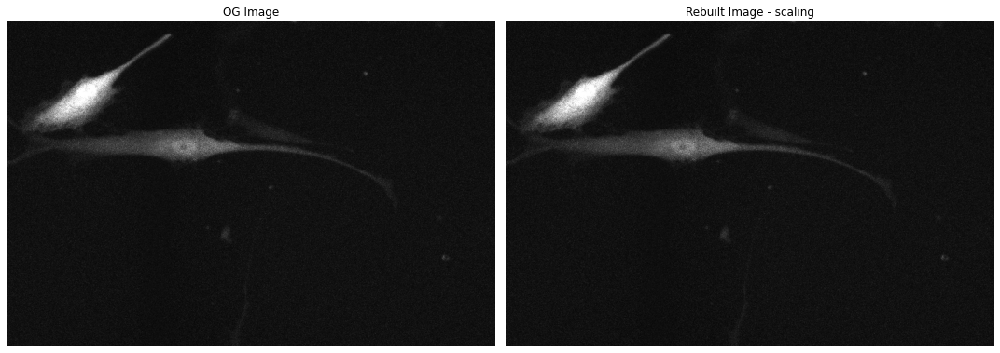

In [ ]:
array = [cropped_img, rebuilt_image]
labels = ["OG Image", "Rebuilt Image - scaling"]

display(array, labels)

## Rebuild Mask

Let's now try to use that with some predictions!

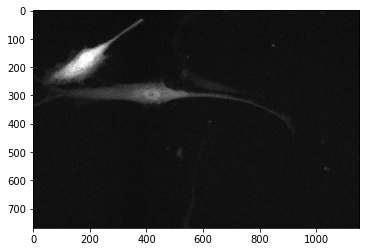

In [ ]:
cropped_img = cropImage( readImage(random_gt_x_paths[4]), 128)

plt.imshow(cropped_img)
plt.show()

In [ ]:
# patchify images
patches = patchifyIndividualImage(cropped_img, patch_size=128)

# predict:
patchified_images = np.array(patches)

patchified_predictions = new_model.predict(patchified_images)

Patchify process starting!
Patchify process complete!
2/2 [==============================] - 2s 785ms/step


In [ ]:
print("Max Value:", np.max(patchified_predictions))
print("Min Value:", np.min(patchified_predictions))
print("Average value:", np.average(patchified_predictions))

Max Value: 0.2352929
Min Value: 0.000345061
Average value: 0.013117774


In [ ]:
# create binary predictions
threshold = 0.1

patchified_predictions_thresh = patchified_predictions 
patchified_predictions_thresh[patchified_predictions_thresh >= threshold] = 1
patchified_predictions_thresh[patchified_predictions_thresh < threshold] = 0

In [ ]:
x, y, _ = np.array(cropped_img).shape

redesigned_images = reshapePatchifiedImages(cropped_img, 
                                            # predicted_mask_patches,
                                            patchified_predictions_thresh, 
                                            height=x, 
                                            width=y, 
                                            patch_size=128, 
                                            invert_scaling=False)

redesigned_images = np.array(redesigned_images)

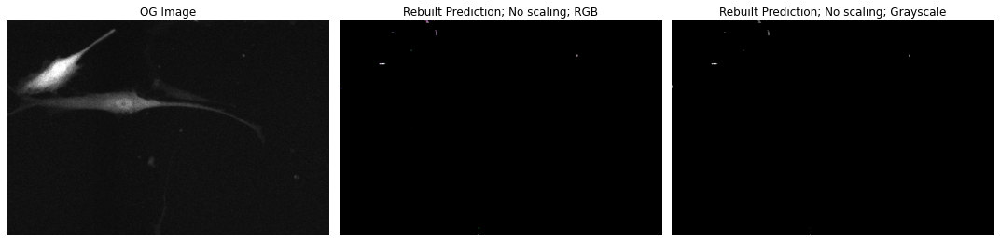

In [ ]:
rebuilt_image = unpatchify(redesigned_images, np.array(cropped_img).shape)

array = [cropped_img, rebuilt_image, convertFloatRGBtoBinary(rebuilt_image) ]
labels = ["OG Image", "Rebuilt Prediction; No scaling; RGB", "Rebuilt Prediction; No scaling; Grayscale"]

display(array, labels)

As shown below, if we invert the scaling with masks, then our final image comes with patches. So we should only do that with original images - our masks do not need to be reverted

In [ ]:
x, y, _ = np.array(cropped_img).shape

redesigned_images = reshapePatchifiedImages(cropped_img, 
                                            # predicted_mask_patches,
                                            patchified_predictions_thresh, 
                                            height=x, 
                                            width=y, 
                                            patch_size=128, 
                                            invert_scaling=True)

redesigned_images = np.array(redesigned_images)

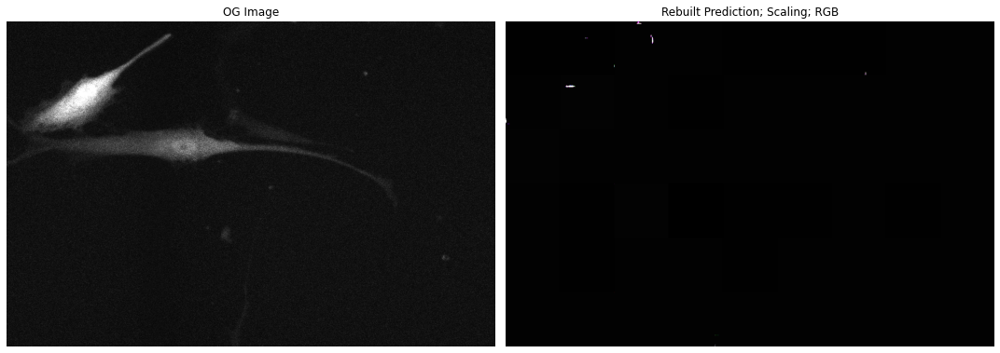

In [ ]:
rebuilt_image = unpatchify(redesigned_images, np.array(cropped_img).shape)

array = [cropped_img, rebuilt_image]
labels = ["OG Image", "Rebuilt Prediction; Scaling; RGB"]

display(array, labels)

# Verify predictions and rebuilding is working

In this section of the notebook, we will load distinct images from the ST and GT folders, and consider how the models built in 012 are predicting them! This will allow us to visualize the results firsthand

## Select random images

In [ ]:
from random import randint

random_gt_x_paths = []
random_gt_y_paths = []
index = 0
count = 0

for paths in gt_x_images:
    # print(paths)
    index = randint(0, len(paths)-1)

    random_gt_x_paths.append(gt_x_images[count][index])
    random_gt_y_paths.append(gt_y_images[count][index])

    count += 1
    print(index, end=" ") 

print()
count = 0
for i in range(len(random_gt_x_paths)):
    if (extractRhsString(random_gt_x_paths[i], "/t") 
        != 
        extractRhsString(random_gt_y_paths[i], "/man_seg")
        ):
        count += 1

print(count, "image(s) do not match")

53 6 4 10 26 4 23 26 7 1 
0 image(s) do not match


In [ ]:
from random import randint

random_st_x_paths = []
random_st_y_paths = []
index = 0
count = 0

for paths in st_x_images:
    # print(paths)
    index = randint(0, len(paths)-1)

    random_st_x_paths.append(st_x_images[count][index])
    random_st_y_paths.append(st_y_images[count][index])

    count += 1 
    print(index, end=" ") 
    
print()
count = 0
for i in range(len(random_st_x_paths)):
    if (extractRhsString(random_st_x_paths[i], "/t") 
        != extractRhsString(random_st_y_paths[i], "/man_seg")):
        count += 1

print(count, "image(s) do not match")

1231 2031 125 1 63 115 43 343 
0 image(s) do not match


## Crop the random Images

In [ ]:
# crop
def bulkCrop(x_paths, y_paths, patch_size):
    cropped_x, cropped_y = [], []

    for i in range(len(x_paths)):
        cropped_x.append( cropImage( readImage(x_paths[i]), patch_size) )
        cropped_y.append( cropImage( readImage(y_paths[i]) , patch_size) )

    return cropped_x, cropped_y
###

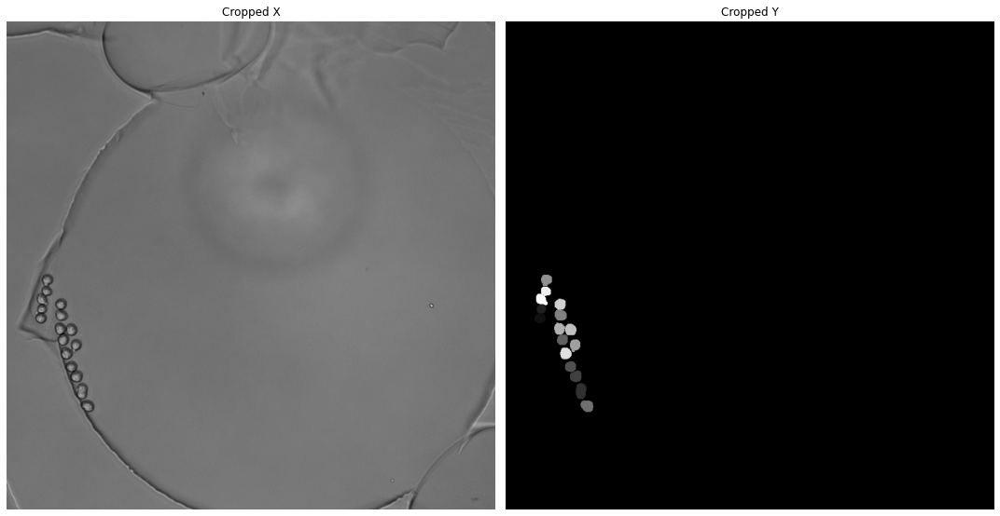

In [ ]:
random_cropped_gt_x, random_cropped_gt_y =  bulkCrop(random_gt_x_paths, random_gt_y_paths, 128)

array = [random_cropped_gt_x[0], random_cropped_gt_y[0]]
labels = ["Cropped X", "Cropped Y"]

display(array, labels)

## Load Model

In [ ]:
from keras.models import load_model

def getModel(path, model_name):
    return load_model(path + model_name)
###

In [ ]:
training_data_code = getcwd() + google_drive_path + "/COMP700_Neural_Network_Code/"
path = training_data_code + "COMP700_UNet_Models/GT_128/"

new_model = getModel(path, "gt_128_model_1")

new_model.summary()

Model: "UNET_Model_Dimension_128_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 Input (InputLayer)             [(None, 128, 128, 3  0           []                               
                                )]                                                                
                                                                                                  
 c1_a (Conv2D)                  (None, 128, 128, 16  448         ['Input[0][0]']                  
                                )                                                                 
                                                                                                  
 c1_b (Dropout)                 (None, 128, 128, 16  0           ['c1_a[0][0]']                   
                                )                                        

## Patchify and predict

In [ ]:
def patchifyAndPredict(image, model, patch_size, threshold=0.5):
    patchified_images = patchifyIndividualImage(image, patch_size=patch_size)

    patchified_images = np.array(patchified_images)
    patchified_predictions = model.predict(patchified_images)

    # adjust threshold here
    threshold = threshold
    patchified_predictions_thresh = patchified_predictions 
    patchified_predictions_thresh[patchified_predictions_thresh >= threshold] = 1
    patchified_predictions_thresh[patchified_predictions_thresh < threshold] = 0

    # fix colours - dont do this, for unpatchify process!
    # answer = []
    # for image in patchified_predictions_thresh:
    #     answer.append( convertFloatRGBtoBinary(image) )

    return patchified_predictions_thresh
###

Patchify process starting!
Patchify process complete!
2/2 [==============================] - 2s 621ms/step


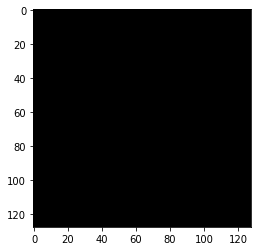

In [ ]:
gt_predicted_patches = patchifyAndPredict(random_cropped_gt_x[0], new_model, 128, threshold=0.1)

plt.imshow(convertFloatRGBtoBinary(gt_predicted_patches[5]), cmap='gray')
plt.show()

## Rebuild Images

In [ ]:
def rebuildImageFromPatches(og_image, image_patches, patch_size, invert_scaling=True):
    height, width, _ = np.array(og_image).shape
    

    redesigned_images = reshapePatchifiedImages(og_image, 
                                                image_patches, 
                                                height, 
                                                width, 
                                                patch_size, 
                                                invert_scaling=invert_scaling)
    # print(np.array(og_image).shape)
    # print(np.array(redesigned_images).shape)
    
    redesigned_images = np.array(redesigned_images)
    rebuilt_image = unpatchify(redesigned_images, np.array(og_image).shape)
    
    return rebuilt_image
###

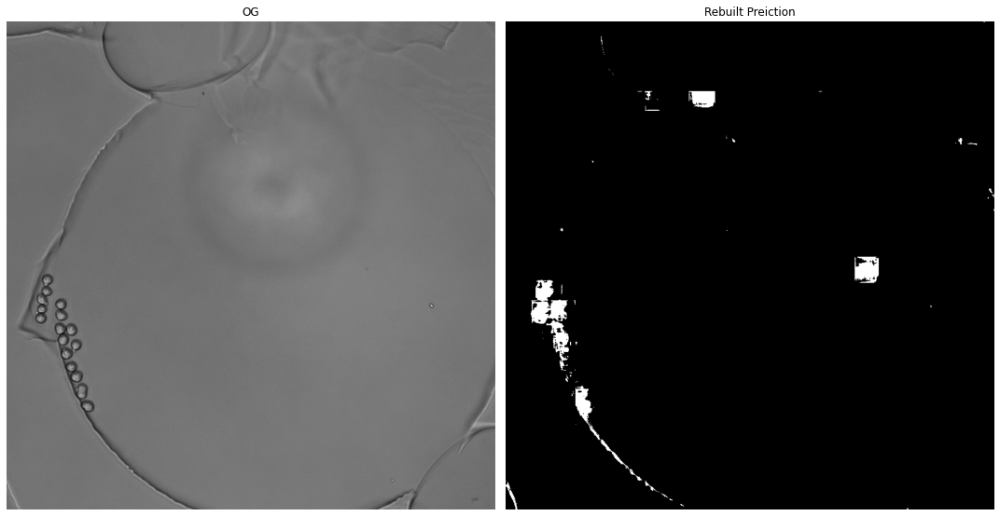

In [ ]:
rebuilt_image = rebuildImageFromPatches(random_cropped_gt_x[0], 
                                        gt_predicted_patches, 
                                        128, 
                                        invert_scaling=False)

array = [random_cropped_gt_x[0], convertFloatRGBtoBinary(rebuilt_image)]
labels = ["OG", "Rebuilt Preiction"]
display(array, labels)

In [ ]:
# # img = cropImage( readImage(random_gt_y_paths[4]), 256)
# img = readImage(random_gt_y_paths[4])

# print(np.max(img))
# print(np.min(img))

# # create binary predictions
# # threshold = 0.2

# # patchified_predictions_thresh = patchified_predictions 
# # patchified_predictions_thresh[patchified_predictions_thresh >= threshold] = 1
# # patchified_predictions_thresh[patchified_predictions_thresh < threshold] = 0

# # plt.imshow(img, cmap="gray")
# # plt.savefig("Cropped Binary Mask")


# # # print(np.array(img).shape)
# # plt.imshow(img, cmap="gray")
# # # # plt.show()
# # plt.savefig("Cropped Mask")

# # patches = patchifyIndividualImage(img, patch_size=256)
# # # len(patches)

# # for i in range(len(patches)):
# #   plt.imshow(patches[i])
# #   plt.savefig("Patch_" + str(i+1)+".png")

# # training_data_code = getcwd() + google_drive_path + "/COMP700_Neural_Network_Code/"
# # path = training_data_code + "COMP700_UNet_Models/GT_256/"

# # new_model = getModel(path, "gt_256_model_2")

# # new_model.summary()

# # predicted_patches = patchifyAndPredict(img, new_model, 256, threshold=0.2)

# # for i in range(len(predicted_patches)):
# #   plt.imshow(predicted_patches[i])
# #   plt.savefig("Predicted_Patch_" + str(i+1)+".png")

# # rebuilt_image = rebuildImageFromPatches(img, 
# #                                         predicted_patches, 
# #                                         256, 
# #                                         invert_scaling=False)

# # plt.imshow(rebuilt_image, cmap="gray")
# # plt.savefig("Rebuilt Image")

255
0


## Predict and Show

In [ ]:
# expects images of patch_size
def conductPrediction(image, patch_size, path, model, threshold = 0.5, invert_scaling=True):

    predicted_patches = patchifyAndPredict(image, model, patch_size, threshold=threshold)

    rebuilt_image = rebuildImageFromPatches(image, 
                                            predicted_patches, 
                                            patch_size, 
                                            invert_scaling=invert_scaling
                                            )
    
    # fix colours and return
    return convertFloatRGBtoBinary(rebuilt_image)
###


def getBinaryClasses(mask_array):
    answer = []
    for image in mask_array:
        temp = image
        temp[temp > 0] = 1
        answer.append(temp)

    return answer
###

In [ ]:
training_data_code = getcwd() + google_drive_path + "/COMP700_Neural_Network_Code/"
path = training_data_code + "COMP700_UNet_Models/GT_128/"
model_name = "gt_128_model_1"

random_cropped_gt_x, random_cropped_gt_y =  bulkCrop(random_gt_x_paths, random_gt_y_paths, 128)
random_cropped_gt_y = getBinaryClasses(random_cropped_gt_y) # doesnt impact preditions, used for visualizations only
array = []
labels = []

# load model
model = getModel(path, model_name)

for i in range(len(random_cropped_gt_x)):
    prediction = conductPrediction(random_cropped_gt_x[i],
                                   patch_size = 128,
                                   path = path,
                                   model = model, 
                                   threshold = 0.1,
                                   invert_scaling=False
                                   )
    
    array.append( [random_cropped_gt_x[i], random_cropped_gt_y[i], prediction] )
    labels.append( ["X_" + str(i+1), "Y_" + str(i+1), "Prediction_" + str(i+1)] )

Patchify process starting!
Patchify process complete!
2/2 [==============================] - 2s 687ms/step
Patchify process starting!
Patchify process complete!
2/2 [==============================] - 2s 1s/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 1s 664ms/step
Patchify process starting!
Patchify process complete!
2/2 [==============================] - 3s 1s/step
Patchify process starting!
Patchify process complete!
2/2 [==============================] - 2s 871ms/step
Patchify process starting!
Patchify process complete!
2/2 [==============================] - 2s 1s/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 1s 1s/step
Patchify process starting!
Patchify process complete!
2/2 [==============================] - 2s 337ms/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 1s 814ms/step
Patchify process starting!
Patchify process compl

In [ ]:
from tensorflow import keras
from keras.utils import array_to_img

def display2DPlot(display_list, title, figsize=(15, 15)):
    plt.figure(figsize=figsize)
    counter = 0

    for i in range(len(display_list)):
        for j in range(len(display_list[0])):
            counter += 1
            plt.subplot(len(display_list), len(display_list[0]), counter)
            plt.title(title[i][j], wrap=True)
            
            # handle 2D and 3D images
            if (len(display_list[i][j].shape) == 3 ):
                plt.imshow( array_to_img(display_list[i][j]), cmap="gray")
            else:
                plt.imshow( display_list[i][j], cmap="gray")
                
            plt.axis('off')
            
        
        # print("i", i)

    plt.tight_layout() # prevents overlap
    plt.show()
###


<Figure size 432x288 with 0 Axes>

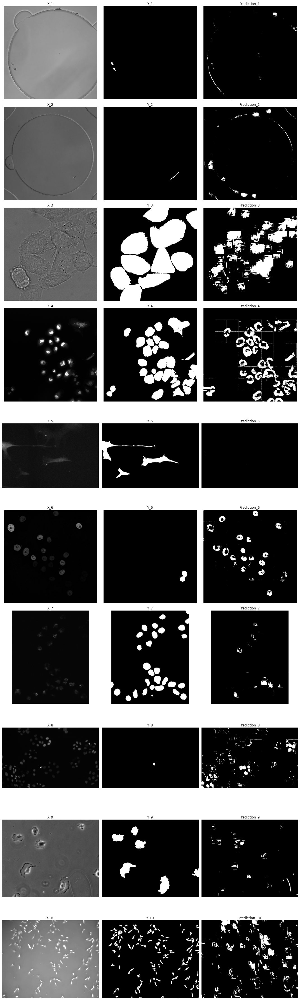

In [ ]:
# array = np.array(array)
display2DPlot(array, labels, figsize=(15,50))

# Reflect on model performance

## Select random images

In [ ]:
from random import randint

random_gt_x_paths = []
random_gt_y_paths = []
index = 0
count = 0

for paths in gt_x_images:
    # print(paths)
    index = randint(0, len(paths)-1)

    random_gt_x_paths.append(gt_x_images[count][index])
    random_gt_y_paths.append(gt_y_images[count][index])

    count += 1
    print(index, end=" ") 

print()
count = 0
for i in range(len(random_gt_x_paths)):
    if (extractRhsString(random_gt_x_paths[i], "/t") 
        != 
        extractRhsString(random_gt_y_paths[i], "/man_seg")
        ):
        count += 1

print(count, "image(s) do not match")

15 96 3 8 8 15 11 28 23 0 
0 image(s) do not match


In [ ]:
from random import randint

random_st_x_paths = []
random_st_y_paths = []
index = 0
count = 0

for paths in st_x_images:
    # print(paths)
    index = randint(0, len(paths)-1)

    random_st_x_paths.append(st_x_images[count][index])
    random_st_y_paths.append(st_y_images[count][index])

    count += 1 
    print(index, end=" ") 
    
print()
count = 0
for i in range(len(random_st_x_paths)):
    if (extractRhsString(random_st_x_paths[i], "/t") 
        != extractRhsString(random_st_y_paths[i], "/man_seg")):
        count += 1

print(count, "image(s) do not match")

272 172 88 37 49 177 36 421 
0 image(s) do not match


## Conduct Bulk Predictions

In [ ]:
def conductBulkPrediction(cropped_x, cropped_y, patch_size, path, model_name, threshold=0.5):
    random_cropped_x, random_cropped_y =  bulkCrop(cropped_x, cropped_y, patch_size)
    random_cropped_y = getBinaryClasses(random_cropped_y) # doesnt impact preditions, used for visualizations only

    model = getModel(path, model_name)    # load model
    array, labels = [], []

    for i in range(len(random_cropped_x)):
        prediction = conductPrediction(random_cropped_x[i],
                                      patch_size = patch_size,
                                      path = path,
                                      model = model, 
                                      threshold = threshold,
                                      invert_scaling=False
                                      )
        
        array.append( [random_cropped_x[i], random_cropped_y[i], prediction] )
        labels.append( ["X_" + str(i+1), "Y_" + str(i+1), "Prediction_" + str(i+1)] )
    
    return array, labels
###

def save2DPlot(display_list, title, location, filename, figsize=(15, 15)):
    plt.figure(figsize=figsize)
    counter = 0

    for i in range(len(display_list)):
        for j in range(len(display_list[0])):
            counter += 1
            plt.subplot(len(display_list), len(display_list[0]), counter)
            plt.title(title[i][j], wrap=True)
            
            # handle 2D and 3D images
            if (len(display_list[i][j].shape) == 3 ):
                plt.imshow( array_to_img(display_list[i][j]), cmap="gray")
            else:
                plt.imshow( display_list[i][j], cmap="gray")
                
            plt.axis('off')
            
        
        # print("i", i)

    plt.tight_layout() # prevents overlap
    plt.savefig(location + filename)
###


In [ ]:
# make directories for images
image_path = getcwd() + google_drive_path + "/COMP700_Images/"

tryMakeDirectories(image_path, ["Matplotlib_Figures", "UNET_Model_Predictions"])


### GT 128 Models

Patchify process starting!
Patchify process complete!
2/2 [==============================] - 2s 711ms/step
Patchify process starting!
Patchify process complete!
2/2 [==============================] - 3s 1s/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 1s 671ms/step
Patchify process starting!
Patchify process complete!
2/2 [==============================] - 3s 1s/step
Patchify process starting!
Patchify process complete!
2/2 [==============================] - 2s 424ms/step
Patchify process starting!
Patchify process complete!
2/2 [==============================] - 3s 1s/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 1s 824ms/step
Patchify process starting!
Patchify process complete!
2/2 [==============================] - 2s 354ms/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 1s 822ms/step
Patchify process starting!
Patchify process co

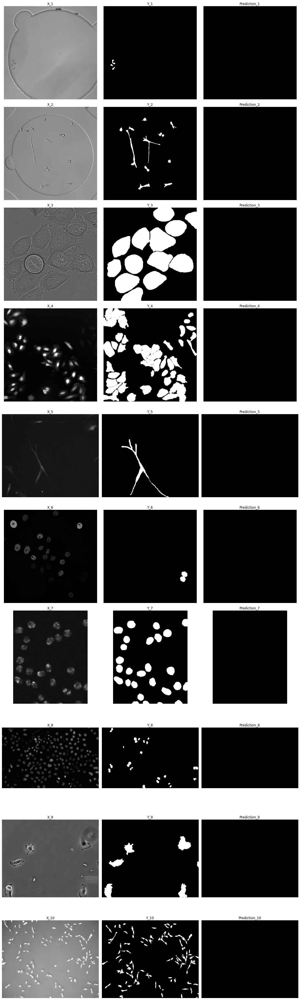

In [ ]:
training_data_code = getcwd() + google_drive_path + "/COMP700_Neural_Network_Code/"
path = training_data_code + "COMP700_UNet_Models/GT_128/"
model_name = "gt_128_model_1"
patch_size = 128

array, labels = conductBulkPrediction(random_gt_x_paths, 
                                      random_gt_y_paths,
                                      patch_size = patch_size,
                                      path = path,
                                      model_name = model_name,
                                      threshold = 0.5
                                      )

location = "/content/drive/MyDrive/COMP700_Images/Matplotlib_Figures/UNET_Model_Predictions/"

save2DPlot(array, labels, location, model_name + "_predictions.png", figsize=(15,50))

Patchify process starting!
Patchify process complete!
2/2 [==============================] - 2s 677ms/step
Patchify process starting!
Patchify process complete!
2/2 [==============================] - 3s 1s/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 1s 669ms/step
Patchify process starting!
Patchify process complete!
2/2 [==============================] - 2s 1s/step
Patchify process starting!
Patchify process complete!
2/2 [==============================] - 2s 411ms/step
Patchify process starting!
Patchify process complete!
2/2 [==============================] - 2s 1s/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 1s 828ms/step
Patchify process starting!
Patchify process complete!
2/2 [==============================] - 2s 351ms/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 1s 828ms/step
Patchify process starting!
Patchify process co

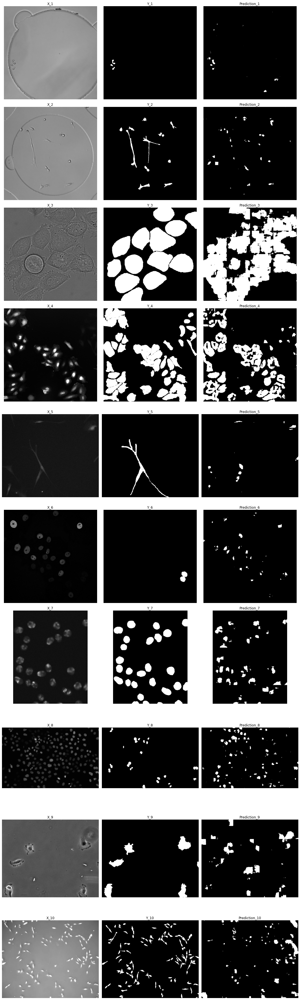

In [ ]:
training_data_code = getcwd() + google_drive_path + "/COMP700_Neural_Network_Code/"
path = training_data_code + "COMP700_UNet_Models/GT_128/"
model_name = "gt_128_model_2"
patch_size = 128

array, labels = conductBulkPrediction(random_gt_x_paths, 
                                      random_gt_y_paths,
                                      patch_size = patch_size,
                                      path = path,
                                      model_name = model_name,
                                      threshold = 0.5
                                      )

location = "/content/drive/MyDrive/COMP700_Images/Matplotlib_Figures/UNET_Model_Predictions/"

save2DPlot(array, labels, location, model_name + "_predictions.png", figsize=(15,50))

Patchify process starting!
Patchify process complete!
2/2 [==============================] - 2s 694ms/step
Patchify process starting!
Patchify process complete!
2/2 [==============================] - 3s 1s/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 1s 668ms/step
Patchify process starting!
Patchify process complete!
2/2 [==============================] - 3s 1s/step
Patchify process starting!
Patchify process complete!
2/2 [==============================] - 2s 431ms/step
Patchify process starting!
Patchify process complete!
2/2 [==============================] - 3s 1s/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 1s 820ms/step
Patchify process starting!
Patchify process complete!
2/2 [==============================] - 2s 354ms/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 1s 804ms/step
Patchify process starting!
Patchify process co

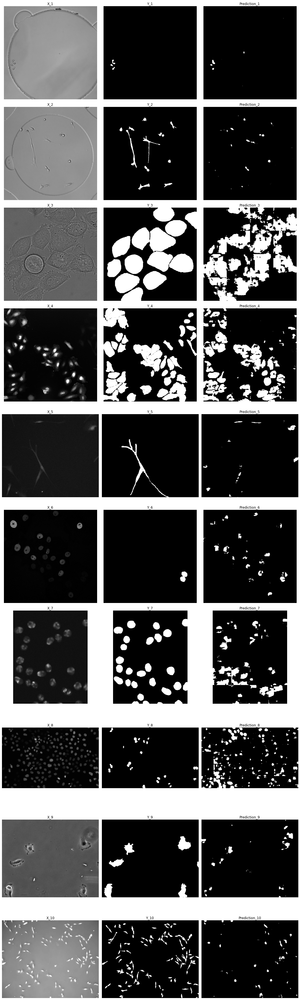

In [ ]:
training_data_code = getcwd() + google_drive_path + "/COMP700_Neural_Network_Code/"
path = training_data_code + "COMP700_UNet_Models/GT_128/"
model_name = "gt_128_model_3"
patch_size = 128

array, labels = conductBulkPrediction(random_gt_x_paths, 
                                      random_gt_y_paths,
                                      patch_size = patch_size,
                                      path = path,
                                      model_name = model_name,
                                      threshold = 0.5
                                      )

location = "/content/drive/MyDrive/COMP700_Images/Matplotlib_Figures/UNET_Model_Predictions/"

save2DPlot(array, labels, location, model_name + "_predictions.png", figsize=(15,50))

### GT 256 Models

Patchify process starting!
Patchify process complete!
1/1 [==============================] - 2s 2s/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 2s 2s/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 1s 669ms/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 2s 2s/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 1s 1s/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 2s 2s/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 1s 684ms/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 1s 1s/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 1s 678ms/step
Patchify process starting!
Patchify process complete!
1

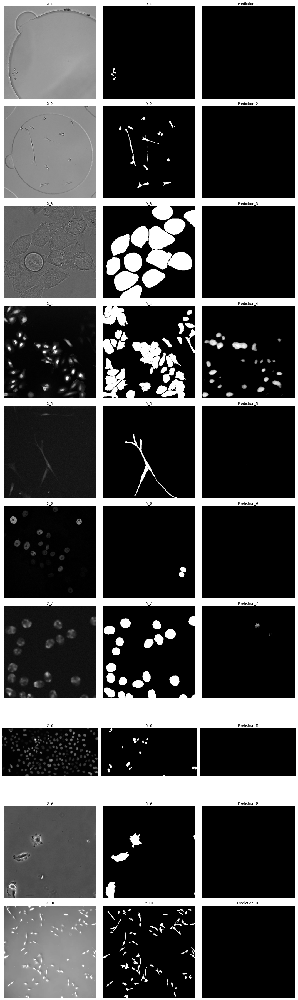

In [ ]:
training_data_code = getcwd() + google_drive_path + "/COMP700_Neural_Network_Code/"
path = training_data_code + "COMP700_UNet_Models/GT_256/"
model_name = "gt_256_model_1"
patch_size = 256

array, labels = conductBulkPrediction(random_gt_x_paths, 
                                      random_gt_y_paths,
                                      patch_size = patch_size,
                                      path = path,
                                      model_name = model_name,
                                      threshold = 0.5
                                      )

location = "/content/drive/MyDrive/COMP700_Images/Matplotlib_Figures/UNET_Model_Predictions/"

save2DPlot(array, labels, location, model_name + "_predictions.png", figsize=(15,50))

Patchify process starting!
Patchify process complete!
1/1 [==============================] - 2s 2s/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 2s 2s/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 1s 654ms/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 2s 2s/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 1s 1s/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 2s 2s/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 1s 693ms/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 1s 1s/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 1s 677ms/step
Patchify process starting!
Patchify process complete!
1

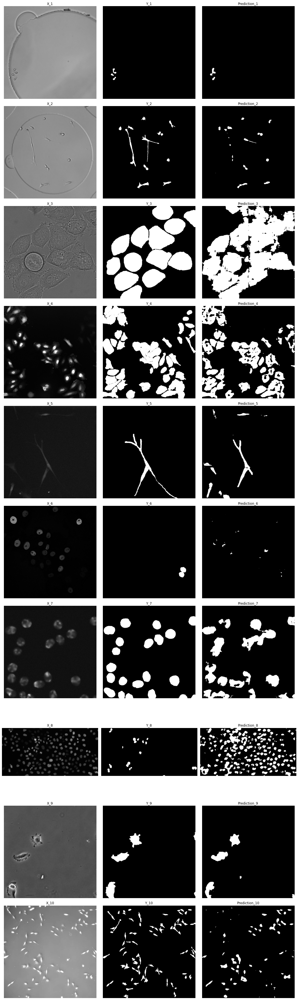

In [ ]:
training_data_code = getcwd() + google_drive_path + "/COMP700_Neural_Network_Code/"
path = training_data_code + "COMP700_UNet_Models/GT_256/"
model_name = "gt_256_model_2"
patch_size = 256

array, labels = conductBulkPrediction(random_gt_x_paths, 
                                      random_gt_y_paths,
                                      patch_size = patch_size,
                                      path = path,
                                      model_name = model_name,
                                      threshold = 0.5
                                      )

location = "/content/drive/MyDrive/COMP700_Images/Matplotlib_Figures/UNET_Model_Predictions/"

save2DPlot(array, labels, location, model_name + "_predictions.png", figsize=(15,50))

Patchify process starting!
Patchify process complete!
1/1 [==============================] - 2s 2s/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 2s 2s/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 1s 667ms/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 2s 2s/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 1s 1s/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 2s 2s/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 1s 662ms/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 1s 1s/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 1s 672ms/step
Patchify process starting!
Patchify process complete!
1

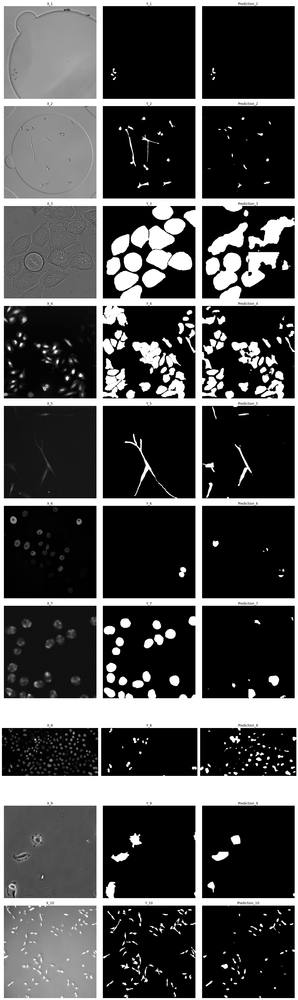

In [ ]:
training_data_code = getcwd() + google_drive_path + "/COMP700_Neural_Network_Code/"
path = training_data_code + "COMP700_UNet_Models/GT_256/"
model_name = "gt_256_model_3"
patch_size = 256

array, labels = conductBulkPrediction(random_gt_x_paths, 
                                      random_gt_y_paths,
                                      patch_size = patch_size,
                                      path = path,
                                      model_name = model_name,
                                      threshold = 0.5
                                      )

location = "/content/drive/MyDrive/COMP700_Images/Matplotlib_Figures/UNET_Model_Predictions/"

save2DPlot(array, labels, location, model_name + "_predictions.png", figsize=(15,50))

### GT 512 Models

Patchify process starting!
Patchify process complete!
1/1 [==============================] - 1s 923ms/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 2s 2s/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 1s 679ms/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 2s 2s/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 1s 664ms/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 2s 2s/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 1s 649ms/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 1s 1s/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 1s 654ms/step
Patchify process starting!
Patchify process compl

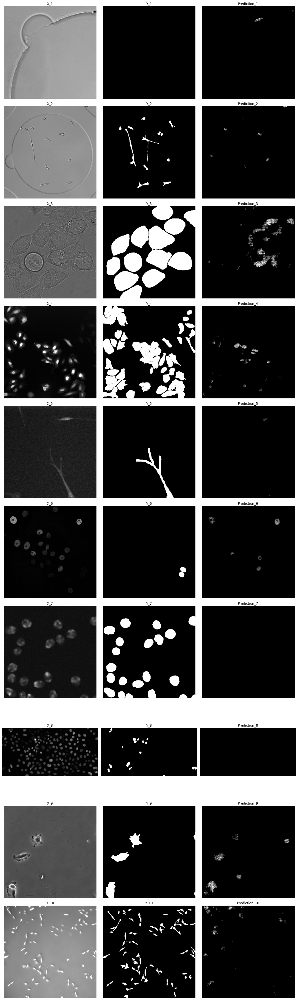

In [ ]:
training_data_code = getcwd() + google_drive_path + "/COMP700_Neural_Network_Code/"
path = training_data_code + "COMP700_UNet_Models/GT_512/"
model_name = "gt_512_model_1"
patch_size = 512

array, labels = conductBulkPrediction(random_gt_x_paths, 
                                      random_gt_y_paths,
                                      patch_size = patch_size,
                                      path = path,
                                      model_name = model_name,
                                      threshold = 0.5
                                      )

location = "/content/drive/MyDrive/COMP700_Images/Matplotlib_Figures/UNET_Model_Predictions/"

save2DPlot(array, labels, location, model_name + "_predictions.png", figsize=(15,50))

Patchify process starting!
Patchify process complete!
1/1 [==============================] - 1s 902ms/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 2s 2s/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 1s 652ms/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 2s 2s/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 1s 656ms/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 2s 2s/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 1s 660ms/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 1s 1s/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 1s 653ms/step
Patchify process starting!
Patchify process compl

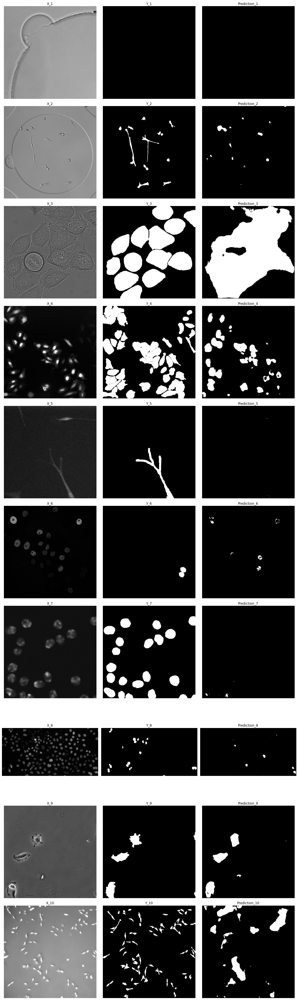

In [ ]:
training_data_code = getcwd() + google_drive_path + "/COMP700_Neural_Network_Code/"
path = training_data_code + "COMP700_UNet_Models/GT_512/"
model_name = "gt_512_model_2"
patch_size = 512

array, labels = conductBulkPrediction(random_gt_x_paths, 
                                      random_gt_y_paths,
                                      patch_size = patch_size,
                                      path = path,
                                      model_name = model_name,
                                      threshold = 0.5
                                      )

location = "/content/drive/MyDrive/COMP700_Images/Matplotlib_Figures/UNET_Model_Predictions/"

save2DPlot(array, labels, location, model_name + "_predictions.png", figsize=(15,50))

Patchify process starting!
Patchify process complete!
1/1 [==============================] - 1s 953ms/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 2s 2s/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 1s 668ms/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 2s 2s/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 1s 666ms/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 2s 2s/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 1s 663ms/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 1s 1s/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 1s 677ms/step
Patchify process starting!
Patchify process compl

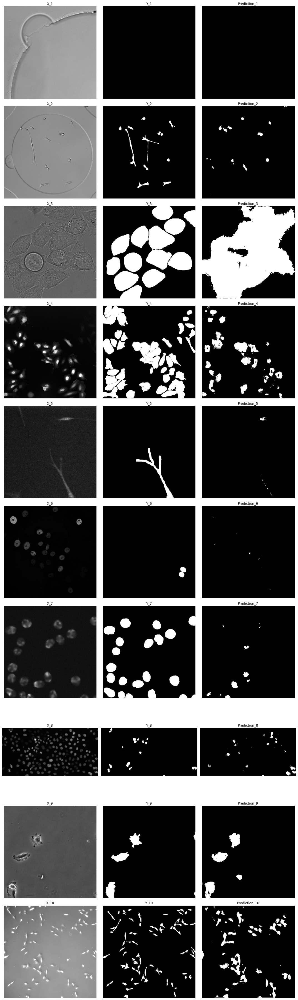

In [ ]:
training_data_code = getcwd() + google_drive_path + "/COMP700_Neural_Network_Code/"
path = training_data_code + "COMP700_UNet_Models/GT_512/"
model_name = "gt_512_model_3"
patch_size = 512

array, labels = conductBulkPrediction(random_gt_x_paths, 
                                      random_gt_y_paths,
                                      patch_size = patch_size,
                                      path = path,
                                      model_name = model_name,
                                      threshold = 0.5
                                      )

location = "/content/drive/MyDrive/COMP700_Images/Matplotlib_Figures/UNET_Model_Predictions/"

save2DPlot(array, labels, location, model_name + "_predictions.png", figsize=(15,50))

### ST 128 Models

Patchify process starting!
Patchify process complete!
2/2 [==============================] - 2s 698ms/step
Patchify process starting!
Patchify process complete!
2/2 [==============================] - 3s 1s/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 1s 669ms/step
Patchify process starting!
Patchify process complete!
2/2 [==============================] - 2s 468ms/step
Patchify process starting!
Patchify process complete!
2/2 [==============================] - 3s 1s/step
Patchify process starting!
Patchify process complete!
2/2 [==============================] - 2s 369ms/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 1s 834ms/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 1s 819ms/step


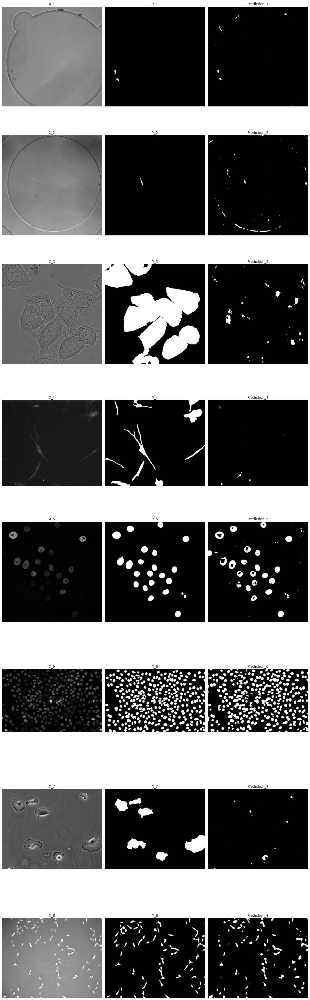

In [ ]:
training_data_code = getcwd() + google_drive_path + "/COMP700_Neural_Network_Code/"
path = training_data_code + "COMP700_UNet_Models/ST_128/"
model_name = "st_128_model_1"
patch_size = 128

array, labels = conductBulkPrediction(random_st_x_paths, 
                                      random_st_y_paths,
                                      patch_size = patch_size,
                                      path = path,
                                      model_name = model_name,
                                      threshold = 0.5
                                      )

location = "/content/drive/MyDrive/COMP700_Images/Matplotlib_Figures/UNET_Model_Predictions/"

save2DPlot(array, labels, location, model_name + "_predictions.png", figsize=(15,50))

Patchify process starting!
Patchify process complete!
2/2 [==============================] - 2s 712ms/step
Patchify process starting!
Patchify process complete!
2/2 [==============================] - 3s 1s/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 1s 667ms/step
Patchify process starting!
Patchify process complete!
2/2 [==============================] - 2s 443ms/step
Patchify process starting!
Patchify process complete!
2/2 [==============================] - 3s 1s/step
Patchify process starting!
Patchify process complete!
2/2 [==============================] - 2s 367ms/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 1s 854ms/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 1s 828ms/step


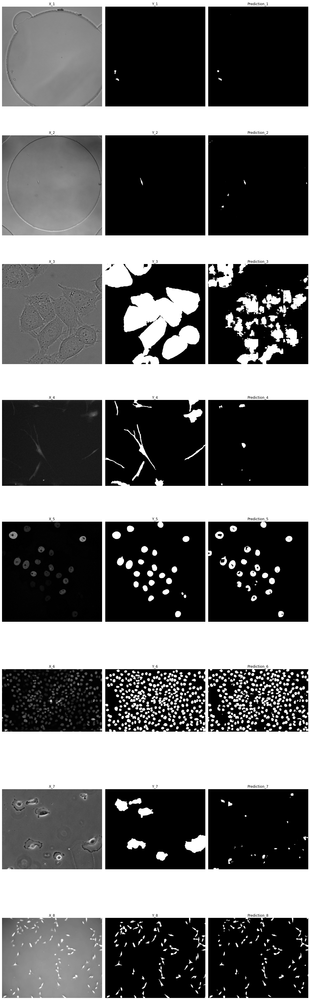

In [ ]:
training_data_code = getcwd() + google_drive_path + "/COMP700_Neural_Network_Code/"
path = training_data_code + "COMP700_UNet_Models/ST_128/"
model_name = "st_128_model_2"
patch_size = 128

array, labels = conductBulkPrediction(random_st_x_paths, 
                                      random_st_y_paths,
                                      patch_size = patch_size,
                                      path = path,
                                      model_name = model_name,
                                      threshold = 0.5
                                      )

location = "/content/drive/MyDrive/COMP700_Images/Matplotlib_Figures/UNET_Model_Predictions/"

save2DPlot(array, labels, location, model_name + "_predictions.png", figsize=(15,50))

Patchify process starting!
Patchify process complete!
2/2 [==============================] - 2s 688ms/step
Patchify process starting!
Patchify process complete!
2/2 [==============================] - 3s 1s/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 1s 682ms/step
Patchify process starting!
Patchify process complete!
2/2 [==============================] - 2s 423ms/step
Patchify process starting!
Patchify process complete!
2/2 [==============================] - 3s 1s/step
Patchify process starting!
Patchify process complete!
2/2 [==============================] - 2s 352ms/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 1s 812ms/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 1s 828ms/step


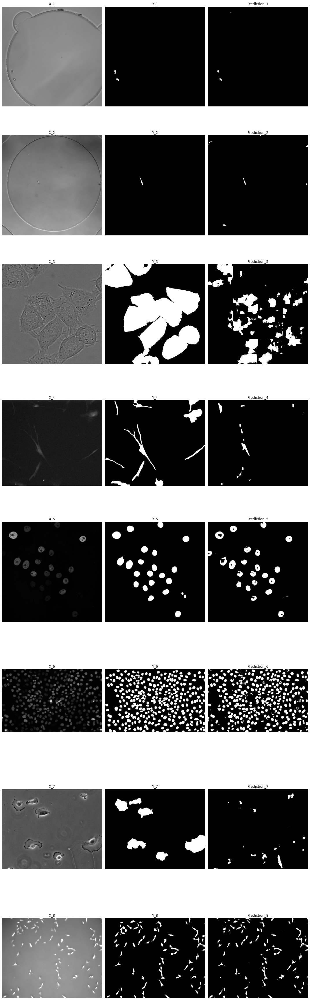

In [ ]:
training_data_code = getcwd() + google_drive_path + "/COMP700_Neural_Network_Code/"
path = training_data_code + "COMP700_UNet_Models/ST_128/"
model_name = "st_128_model_3"
patch_size = 128

array, labels = conductBulkPrediction(random_st_x_paths, 
                                      random_st_y_paths,
                                      patch_size = patch_size,
                                      path = path,
                                      model_name = model_name,
                                      threshold = 0.5
                                      )

location = "/content/drive/MyDrive/COMP700_Images/Matplotlib_Figures/UNET_Model_Predictions/"

save2DPlot(array, labels, location, model_name + "_predictions.png", figsize=(15,50))

### ST 256 Models

Patchify process starting!
Patchify process complete!
1/1 [==============================] - 2s 2s/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 2s 2s/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 1s 656ms/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 1s 1s/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 2s 2s/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 1s 1s/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 1s 666ms/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 1s 698ms/step


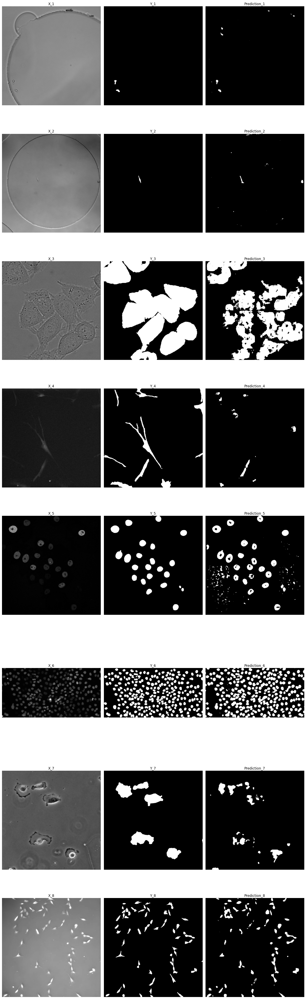

In [ ]:
training_data_code = getcwd() + google_drive_path + "/COMP700_Neural_Network_Code/"
path = training_data_code + "COMP700_UNet_Models/ST_256/"
model_name = "st_256_model_1"
patch_size = 256

array, labels = conductBulkPrediction(random_st_x_paths, 
                                      random_st_y_paths,
                                      patch_size = patch_size,
                                      path = path,
                                      model_name = model_name,
                                      threshold = 0.5
                                      )

location = "/content/drive/MyDrive/COMP700_Images/Matplotlib_Figures/UNET_Model_Predictions/"

save2DPlot(array, labels, location, model_name + "_predictions.png", figsize=(15,50))

Patchify process starting!
Patchify process complete!
1/1 [==============================] - 2s 2s/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 2s 2s/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 1s 658ms/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 1s 1s/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 2s 2s/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 1s 1s/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 1s 653ms/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 1s 662ms/step


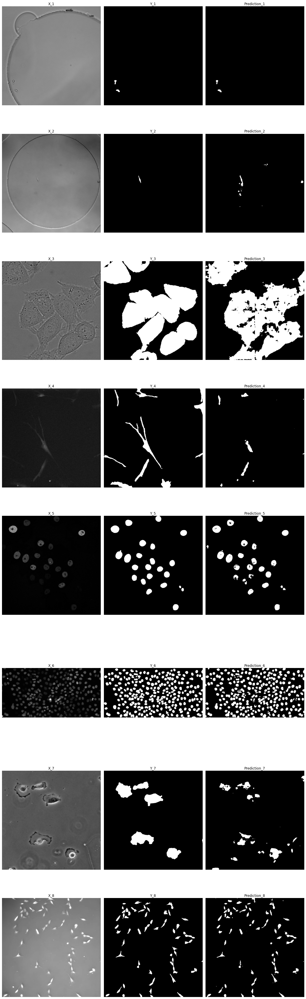

In [ ]:
training_data_code = getcwd() + google_drive_path + "/COMP700_Neural_Network_Code/"
path = training_data_code + "COMP700_UNet_Models/ST_256/"
model_name = "st_256_model_2"
patch_size = 256

array, labels = conductBulkPrediction(random_st_x_paths, 
                                      random_st_y_paths,
                                      patch_size = patch_size,
                                      path = path,
                                      model_name = model_name,
                                      threshold = 0.5
                                      )

location = "/content/drive/MyDrive/COMP700_Images/Matplotlib_Figures/UNET_Model_Predictions/"

save2DPlot(array, labels, location, model_name + "_predictions.png", figsize=(15,50))

Patchify process starting!
Patchify process complete!
1/1 [==============================] - 2s 2s/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 2s 2s/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 1s 649ms/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 1s 1s/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 2s 2s/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 1s 1s/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 1s 668ms/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 1s 666ms/step


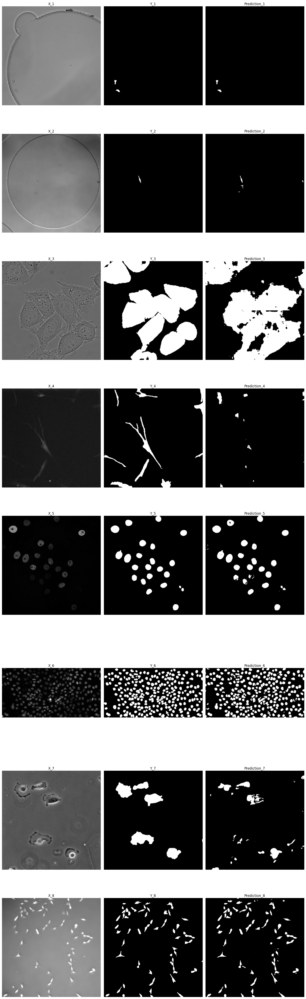

In [ ]:
training_data_code = getcwd() + google_drive_path + "/COMP700_Neural_Network_Code/"
path = training_data_code + "COMP700_UNet_Models/ST_256/"
model_name = "st_256_model_3"
patch_size = 256

array, labels = conductBulkPrediction(random_st_x_paths, 
                                      random_st_y_paths,
                                      patch_size = patch_size,
                                      path = path,
                                      model_name = model_name,
                                      threshold = 0.5
                                      )

location = "/content/drive/MyDrive/COMP700_Images/Matplotlib_Figures/UNET_Model_Predictions/"

save2DPlot(array, labels, location, model_name + "_predictions.png", figsize=(15,50))

### ST 512 Models

Patchify process starting!
Patchify process complete!
1/1 [==============================] - 1s 960ms/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 2s 2s/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 1s 653ms/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 1s 694ms/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 2s 2s/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 1s 1s/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 1s 670ms/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 1s 663ms/step


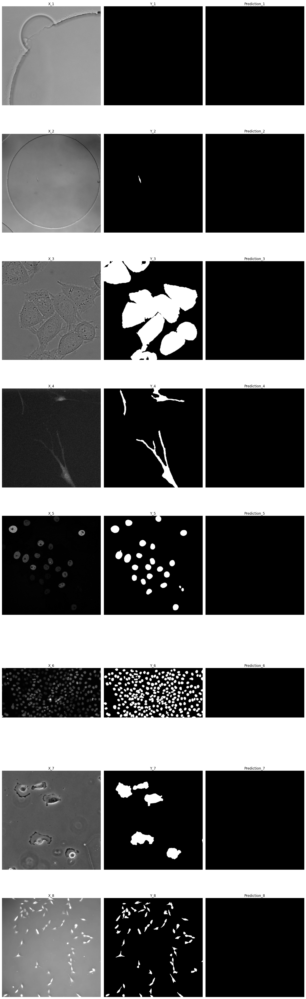

In [ ]:
training_data_code = getcwd() + google_drive_path + "/COMP700_Neural_Network_Code/"
path = training_data_code + "COMP700_UNet_Models/ST_512/"
model_name = "st_512_model_1"
patch_size = 512

array, labels = conductBulkPrediction(random_st_x_paths, 
                                      random_st_y_paths,
                                      patch_size = patch_size,
                                      path = path,
                                      model_name = model_name,
                                      threshold = 0.5
                                      )

location = "/content/drive/MyDrive/COMP700_Images/Matplotlib_Figures/UNET_Model_Predictions/"

save2DPlot(array, labels, location, model_name + "_predictions.png", figsize=(15,50))

Patchify process starting!
Patchify process complete!
1/1 [==============================] - 1s 918ms/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 2s 2s/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 1s 674ms/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 1s 668ms/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 2s 2s/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 1s 1s/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 1s 654ms/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 1s 666ms/step


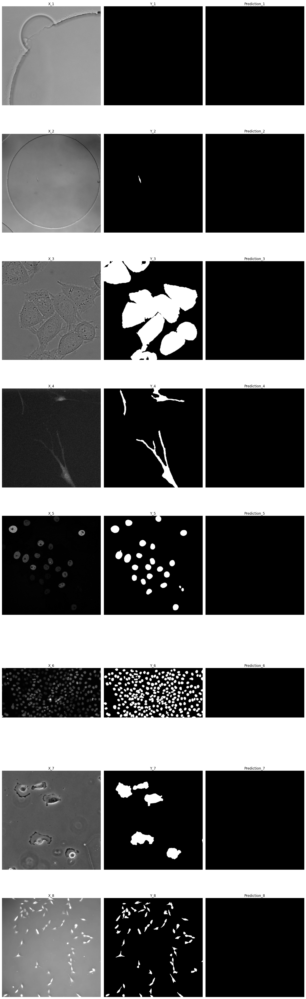

In [ ]:
training_data_code = getcwd() + google_drive_path + "/COMP700_Neural_Network_Code/"
path = training_data_code + "COMP700_UNet_Models/ST_512/"
model_name = "st_512_model_2"
patch_size = 512

array, labels = conductBulkPrediction(random_st_x_paths, 
                                      random_st_y_paths,
                                      patch_size = patch_size,
                                      path = path,
                                      model_name = model_name,
                                      threshold = 0.5
                                      )

location = "/content/drive/MyDrive/COMP700_Images/Matplotlib_Figures/UNET_Model_Predictions/"

save2DPlot(array, labels, location, model_name + "_predictions.png", figsize=(15,50))

Patchify process starting!
Patchify process complete!
1/1 [==============================] - 1s 920ms/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 2s 2s/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 1s 658ms/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 1s 650ms/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 2s 2s/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 1s 1s/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 1s 644ms/step
Patchify process starting!
Patchify process complete!
1/1 [==============================] - 1s 668ms/step


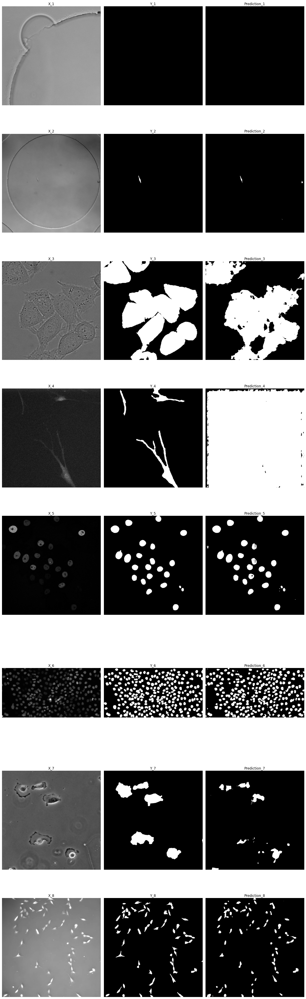

In [ ]:
training_data_code = getcwd() + google_drive_path + "/COMP700_Neural_Network_Code/"
path = training_data_code + "COMP700_UNet_Models/ST_512/"
model_name = "st_512_model_3"
patch_size = 512

array, labels = conductBulkPrediction(random_st_x_paths, 
                                      random_st_y_paths,
                                      patch_size = patch_size,
                                      path = path,
                                      model_name = model_name,
                                      threshold = 0.5
                                      )

location = "/content/drive/MyDrive/COMP700_Images/Matplotlib_Figures/UNET_Model_Predictions/"

save2DPlot(array, labels, location, model_name + "_predictions.png", figsize=(15,50))

# Conclusion

Recall from the beginning of the notebook the following information:

| Dataset | Model Name                  | Patch Size | Mean IoU Score | Observations |
|---------|-----------------------------|------------|----------------|-------|
| GT      | UNET_Model_Dimension_128_1  | 128        | 0.000202       | Fuzzy |
| GT      | UNET_Model_Dimension_128_2  | 128        | 0.232335       | Decent|
| GT      | UNET_Model_Dimension_128_3  | 128        | 0.230308       | Decent|
|         |                             |            |                |       |
| GT      | UNET_Model_Dimension_256_1  | 256        | 0.097374       | Fuzzy |
| GT      | UNET_Model_Dimension_256_2  | 256        | 0.449333       | Mixed |
| GT      | UNET_Model_Dimension_256_3  | 256        | 0.425110       | Decent|
|         |                             |            |                |       |
| GT      | UNET_Model_Dimension_512_1  | 512        | 0.067855       | Fuzzy |
| GT      | UNET_Model_Dimension_512_2  | 512        | 0.262273       | Fuzzy |
| GT      | UNET_Model_Dimension_512_3  | 512        | 0.299222       | Mixed |
|         |                             |            |                |       |
| ST      | UNET_Model_Dimension_128_1  | 128        | 0.428539       | Fuzzy |
| ST      | UNET_Model_Dimension_128_2  | 128        | 0.539064       | Mixed |
| ST      | UNET_Model_Dimension_128_3  | 128        | 0.536814       | Mixed |
|         |                             |            |                |       |
| ST      | UNET_Model_Dimension_256_1  | 256        | 0.548595       | Mixed |
| ST      | UNET_Model_Dimension_256_2  | 256        | 0.729635       | Decent|
| ST      | UNET_Model_Dimension_256_3  | 256        | 0.773320       | Decent|
|         |                             |            |                |       |
| ST      | UNET_Model_Dimension_512_1  | 512        | 1.992501e-06   | Mixed |
| ST      | UNET_Model_Dimension_512_2  | 512        | 0              | Decent|
| ST      | UNET_Model_Dimension_512_3  | 512        | 0.5005644      | Excellent|



In addition to those initial observations, we can now see the following trends, by looking at the matplotlib figures generated above:


| Dataset | Model Name                  | Patch Size | Observations |
|---------|-----------------------------|------------|--------------|
| GT      | UNET_Model_Dimension_128_1  | 128        | Masks Pitch black because of threshold |
| GT      | UNET_Model_Dimension_128_2  | 128        | Poor predictions, but capturing a lot of 'hidden' information |
| GT      | UNET_Model_Dimension_128_3  | 128        | Poor predictions, but capturing a lot of 'hidden' informatio |
|         |                             |            |              |
| GT      | UNET_Model_Dimension_256_1  | 256        | Almost all masks Pitch black because of threshold |
| GT      | UNET_Model_Dimension_256_2  | 256        | Decent predictions! |
| GT      | UNET_Model_Dimension_256_3  | 256        | Decent predictions! |
|         |                             |            |              |
| GT      | UNET_Model_Dimension_512_1  | 512        | Masks poor quality |
| GT      | UNET_Model_Dimension_512_2  | 512        | Fair predictions, but borders 'grow' into one another |
| GT      | UNET_Model_Dimension_512_3  | 512        | Fair predictions, but borders 'grow' into one another |
|         |                             |            |              |
| ST      | UNET_Model_Dimension_128_1  | 128        | Decent predictions, for half of the datasets |
| ST      | UNET_Model_Dimension_128_2  | 128        | Fair predictions, for half of the datasets |
| ST      | UNET_Model_Dimension_128_3  | 128        | Fair predictions, for half of the datasets |
|         |                             |            |              |
| ST      | UNET_Model_Dimension_256_1  | 256        | Fair predictions! |
| ST      | UNET_Model_Dimension_256_2  | 256        | Decent predictions! |
| ST      | UNET_Model_Dimension_256_3  | 256        | Decent predictions! |
|         |                             |            |              |
| ST      | UNET_Model_Dimension_512_1  | 512        | Masks pitch black |
| ST      | UNET_Model_Dimension_512_2  | 512        | Masks pitch black |
| ST      | UNET_Model_Dimension_512_3  | 512        | Fair predictions for half of the datasets |

It is also worth noting that models 2 and models 3 are very similar, in every test - so experimenting with different batch sizes and epochs may further improve results.

Recall that model 2 had 100 epochs, and a batch size of 4 whereas model 3 had 100 epochs, and a batch size of 8

The trends appear to be:

- Patch Size of 128 is poor quality, in either dataset

- 30 epochs is not enough time for training

- Patch Size of 256 appears to be the best performing model so far

- Patch Size of 512 could be beneficial - but we must recall that our training for those images is limited due to RAM issues in google colab

Conclusion: 

- Patch Size of 256 is ideal for experimentation

- 100 epochs is a good starting point, and varying of parameters and optimizers is ideal

- We can now patchify an image, train/predict the patches, unpatchify the image

- We have the option of calculating Mean IoU score from both the patches, as well as the original (cropped) images

In the next notebook, the author will investigate the best performing model on our processed datasets. The next notebook needs to generate the patchified images from the processed image folders, and prepare them in size 256. Thankfully, there are only 2 folders we need. We can also try and load more than 800 training images and 200 training images, and see what quantity of images we can train with, in Google Colab

In notebook 014 we will investigate whether any other processing techniques can be applied, or if we should rather press on with the morphologically processed images